# **Trabalho Final de Mineração de Dados**

by: Hellen Rosa, João Victor Porto e Laura Murayama

## bibliotecas

In [113]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans, DBSCAN
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.neighbors import NearestNeighbors
from sklearn.metrics import silhouette_score, davies_bouldin_score

## dataset

In [114]:
data = pd.read_csv('foundation_tones_complete.csv')

data.head()

,brand,line,tone,cruelty_free,brl_price,usd_price,eur_price,hex_code,rgb_red,rgb_green,rgb_blue,lab_l,lab_a,lab_b,closest_mst,tone_level
0,Adversa,Base Líquida Matte Vegana,050,True,21.0,NaN,NaN,#F5C097,245,192,151,81.482818,13.660913,27.930896,5,light
1,Adversa,Base Líquida Matte Vegana,100,True,21.0,NaN,NaN,#FDD39B,253,211,155,86.918345,7.313724,33.237453,5,light
2,Adversa,Base Líquida Matte Vegana,150,True,21.0,NaN,NaN,#F2C991,242,201,145,83.282688,7.118945,33.407593,5,light
3,Adversa,Base Líquida Matte Vegana,200,True,21.0,NaN,NaN,#F9C685,249,198,133,83.032374,10.225558,39.378735,5,light
4,Adversa,Base Líquida Matte Vegana,250,True,21.0,NaN,NaN,#F2C27A,242,194,122,81.219197,8.490120,42.523206,5,light


In [115]:
# transformar o 'cruelty_free' de booleano pra inteiro
data['cruelty_free'] = data['cruelty_free'].astype(int)
# mapear as palavras 'light' e 'dark' para números 0 e 1 na coluna 'tone_level'
data['tone_level'] = data['tone_level'].replace({'light': 0, 'dark': 1})
data.head()

,brand,line,tone,cruelty_free,brl_price,usd_price,eur_price,hex_code,rgb_red,rgb_green,rgb_blue,lab_l,lab_a,lab_b,closest_mst,tone_level
0,Adversa,Base Líquida Matte Vegana,050,1,21.0,NaN,NaN,#F5C097,245,192,151,81.482818,13.660913,27.930896,5,0
1,Adversa,Base Líquida Matte Vegana,100,1,21.0,NaN,NaN,#FDD39B,253,211,155,86.918345,7.313724,33.237453,5,0
2,Adversa,Base Líquida Matte Vegana,150,1,21.0,NaN,NaN,#F2C991,242,201,145,83.282688,7.118945,33.407593,5,0
3,Adversa,Base Líquida Matte Vegana,200,1,21.0,NaN,NaN,#F9C685,249,198,133,83.032374,10.225558,39.378735,5,0
4,Adversa,Base Líquida Matte Vegana,250,1,21.0,NaN,NaN,#F2C27A,242,194,122,81.219197,8.490120,42.523206,5,0


## Padronizar

In [116]:
# variáveis quantitativas e escolhidas para a análise de cluste'
quantitative_data = data[['cruelty_free','brl_price', 'rgb_red', 'rgb_green','rgb_blue', 'lab_l', 'lab_a', 'lab_b', 'closest_mst', 'tone_level']]

# padronizar os dados
scaler = StandardScaler()
scaled_data = scaler.fit_transform(quantitative_data)

## Algoritmos de clusterização

### Cluster hierarquico

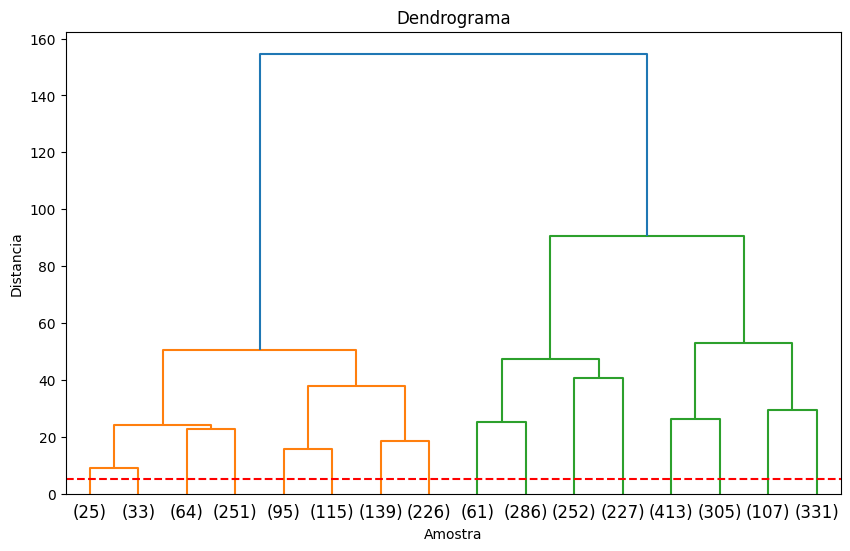

In [117]:
# calcular a matriz de linkage
linkage_matrix = linkage(scaled_data, method='ward', metric='euclidean')

# plotar o dendrograma
plt.figure(figsize=(10, 6))
dendrogram(linkage_matrix, truncate_mode='level', p=3)
plt.title('Dendrograma')
plt.xlabel('Amostra')
plt.ylabel('Distancia')
plt.axhline(y=5, color='r', linestyle='--')
plt.show()

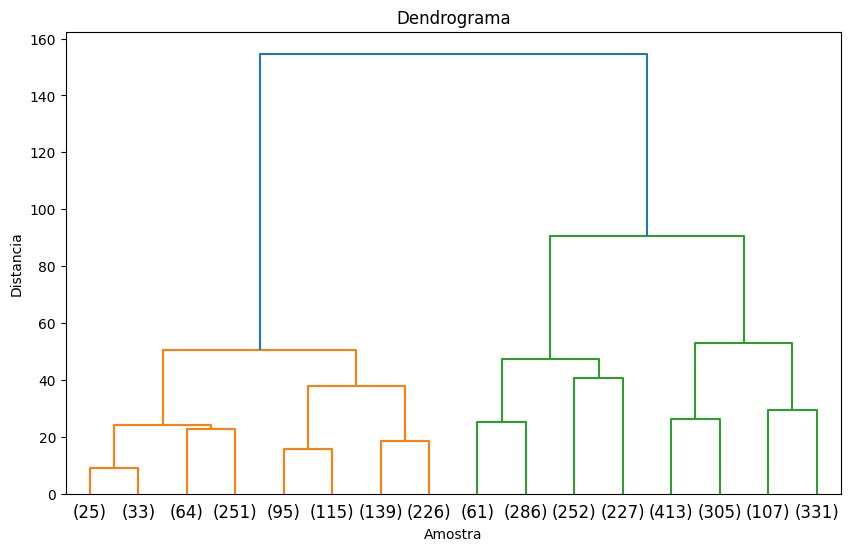

In [118]:
# plotar o dendrograma com a linha para os clusters
plt.figure(figsize=(10, 6))
dendrogram(linkage_matrix, truncate_mode='level', p=3)
plt.title('Dendrograma')
plt.xlabel('Amostra')
plt.ylabel('Distancia')
plt.show()

In [119]:
# com base no dendrograma, escolher o número de clusters
chosen_num_clusters = 3

# realizar o clustering hierárquico com o número escolhido de clusters
from scipy.cluster.hierarchy import fcluster
clusters_hierarquico = fcluster(linkage_matrix, chosen_num_clusters, criterion='maxclust')

In [120]:
# adicionar a coluna de grupos ao DataFrame original
data['Cluster Hierarquico'] = clusters_hierarquico

# salvar o DataFrame com a marcação dos grupos
data.to_excel('cluster_hierarquicos.xlsx', index=False)

# análise descritiva: média e quantidade de registros por grupo
grouped_summary = data.groupby('Cluster Hierarquico')[quantitative_data.columns].agg(['mean', 'count'])
print(grouped_summary)

                    cruelty_free         brl_price           rgb_red         
                            mean count        mean count        mean count   
Cluster Hierarquico                                                          
1                       0.606540   948  168.115812   948  234.123418   948  \
2                       0.725182   826  141.019068   826  133.411622   826   
3                       0.621107  1156  157.739559  1156  201.575260  1156   

                      rgb_green          rgb_blue            lab_l         
                           mean count        mean count       mean count   
Cluster Hierarquico                                                        
1                    196.059072   948  161.468354   948  81.632276   948  \
2                     79.576271   826   46.575061   826  39.206138   826   
3                    148.130623  1156  106.927336  1156  65.545685  1156   

                         lab_a            lab_b       closest_mst         

#### Métricas

In [121]:
# calcule o coeficiente de silhueta
silhouette_avg = silhouette_score(scaled_data, clusters_hierarquico)
print(f"Coeficiente de Silhueta: {silhouette_avg}")

Coeficiente de Silhueta: 0.29266236081099384


In [122]:
# calcule o Índice Davies-Bouldin
dbi = davies_bouldin_score(scaled_data, clusters_hierarquico)
print(f"Índice Davies-Bouldin: {dbi}")

Índice Davies-Bouldin: 1.3229689922409358


### K-means

In [123]:
# encontrar o número ideal de clusters usando o método Elbow
inertia_values = []
for k in range(2, 11):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(scaled_data)
    inertia_values.append(kmeans.inertia_)

/Users/hellenrosa/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/Users/hellenrosa/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/Users/hellenrosa/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/Users/hellenrosa/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/Users/hellenrosa/anaconda3/lib/python3.10/site-packages

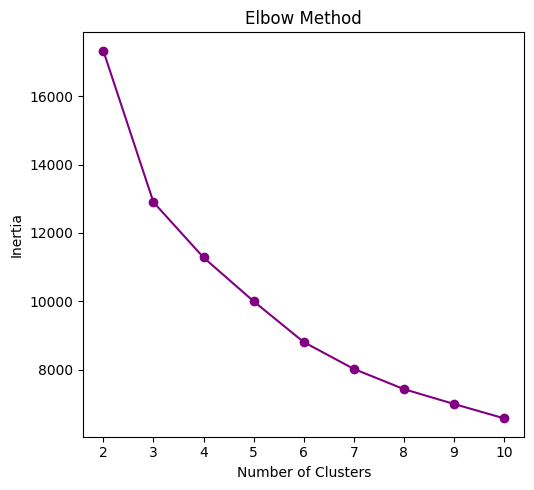

In [124]:
# plotar o gráfico Elbow para ajudar a escolher o número de clusters
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.plot(range(2, 11), inertia_values, marker='o', color='purple')
plt.title('Elbow Method')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')

plt.tight_layout()
plt.show()

In [125]:
# escolher o número de clusters com base na análise dos gráficos acima
chosen_num_clusters = 3

# realizar a clusterização com o número escolhido de clusters
kmeans = KMeans(n_clusters=chosen_num_clusters, random_state=42)
clusters_kmeans = kmeans.fit_predict(scaled_data)

/Users/hellenrosa/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



In [126]:
# adicionar a coluna de grupos ao DataFrame original
data['Kmeans'] = clusters_kmeans

# salvar o DataFrame com a marcação dos grupos
data.to_excel('cluster_kmeans.xlsx', index=False)

# análise descritiva: média e quantidade de registros por grupo
grouped_summary = data.groupby('Kmeans')[quantitative_data.columns].agg(['mean', 'count'])
print(grouped_summary)


       cruelty_free         brl_price           rgb_red         rgb_green   
               mean count        mean count        mean count        mean   
Kmeans                                                                      
0          0.605932   944  168.088824   944  234.118644   944  196.155720  \
1          0.736842   665  139.904030   665  121.315789   665   70.815038   
2          0.628312  1321  156.313732  1321  199.458743  1321  144.261923   

                rgb_blue            lab_l            lab_a            lab_b   
       count        mean count       mean count       mean count       mean   
Kmeans                                                                        
0        944  161.716102   944  81.659341   944   8.743907   944  22.422653  \
1        665   42.436090   665  35.377737   665  18.814867   665  25.690308   
2       1321  101.643452  1321  64.292101  1321  16.005744  1321  30.849811   

             closest_mst       tone_level        
       count

#### Métricas

In [127]:
# coeficiente de silhueta
silhouette_avg = silhouette_score(scaled_data, clusters_kmeans)
print(f"Coeficiente de Silhueta: {silhouette_avg}")

# indice Davies-Bouldin
dbi = davies_bouldin_score(scaled_data, clusters_kmeans)
print(f"Índice Davies-Bouldin: {dbi}")

# inércia do modelo KMeans
inertia = kmeans.inertia_
print(f"Inércia do KMeans: {inertia}")

Coeficiente de Silhueta: 0.3158346126595907
Índice Davies-Bouldin: 1.2283216983334981
Inércia do KMeans: 12902.72385763541


### DBScan

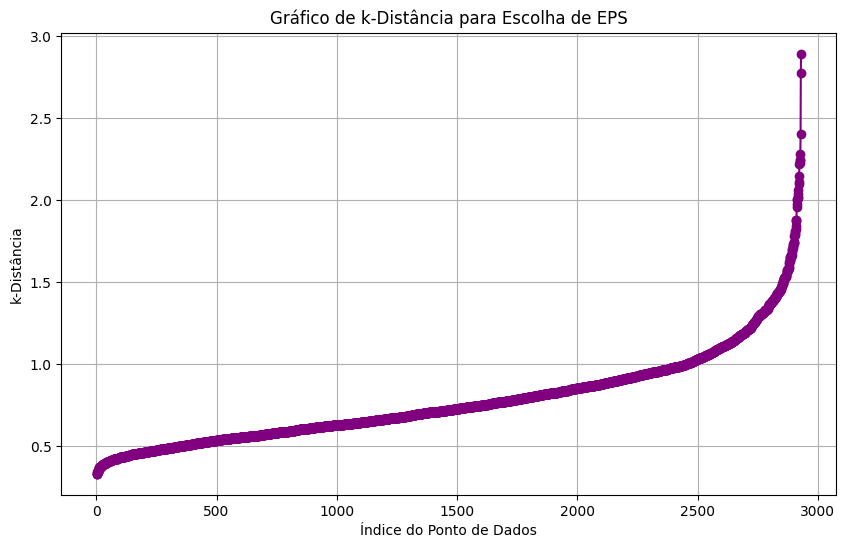

In [128]:
# calcule as k-distâncias
k = 12  # Defina o número de vizinhos mais próximos (ajuste conforme necessário)
nbrs = NearestNeighbors(n_neighbors=k).fit(scaled_data)  # Use seus dados padronizados
distances, _ = nbrs.kneighbors(scaled_data)

# ordene as k-distâncias em ordem decrescente
k_distances = np.sort(distances[:, -1])

# plote o gráfico de k-distância
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(k_distances) + 1), k_distances, marker='o', color='purple')
plt.title('Gráfico de k-Distância para Escolha de EPS')
plt.xlabel('Índice do Ponto de Dados')
plt.ylabel('k-Distância')
plt.grid(True)
#plt.ylim(0, 2) 

# Exiba o gráfico
plt.show()

In [129]:
# realizar a clusterização com DBSCAN
dbscan = DBSCAN(eps=0.6, min_samples=20)
clusters_dbscan = dbscan.fit_predict(scaled_data)

In [130]:
# adicionar a coluna de grupos ao DataFrame original
data['DBScan'] = clusters_dbscan

# salvar o DataFrame com a marcação dos grupos
data.to_excel('cluster_dbscan.xlsx', index=False)


# análise descritiva: média e quantidade de registros por grupo
grouped_summary = data.groupby('DBScan')[quantitative_data.columns].agg(['mean', 'count'])
print(grouped_summary)

       cruelty_free         brl_price           rgb_red         rgb_green   
               mean count        mean count        mean count        mean   
DBScan                                                                      
-1         0.622901  1965  160.608677  1965  179.116539  1965  129.210178  \
 0         1.000000    88  192.177614    88  237.340909    88  195.102273   
 1         1.000000    27  205.670370    27  214.222222    27  161.962963   
 2         1.000000    47  190.701489    47  241.957447    47  208.702128   
 3         1.000000   160   72.422812   160  234.331250   160  192.500000   
 4         1.000000    49   79.404286    49  191.959184    49  135.714286   
 5         1.000000   212   69.823632   212  209.693396   212  155.146226   
 6         1.000000    18   70.737778    18  169.666667    18  111.833333   
 7         1.000000    48   70.474792    48  241.770833    48  213.270833   
 8         1.000000    19   76.877895    19  227.947368    19  189.263158   

#### Métricas

In [131]:
# coeficiente de silhueta
silhouette_avg = silhouette_score(scaled_data, clusters_dbscan)
print(f"Coeficiente de Silhueta: {silhouette_avg}")

# indice Davies-Bouldin
dbi = davies_bouldin_score(scaled_data, clusters_dbscan)
print(f"Índice Davies-Bouldin: {dbi}")

Coeficiente de Silhueta: -0.22494439587021192
Índice Davies-Bouldin: 1.6525061076452656


## Avaliar resultados

### Pairplot

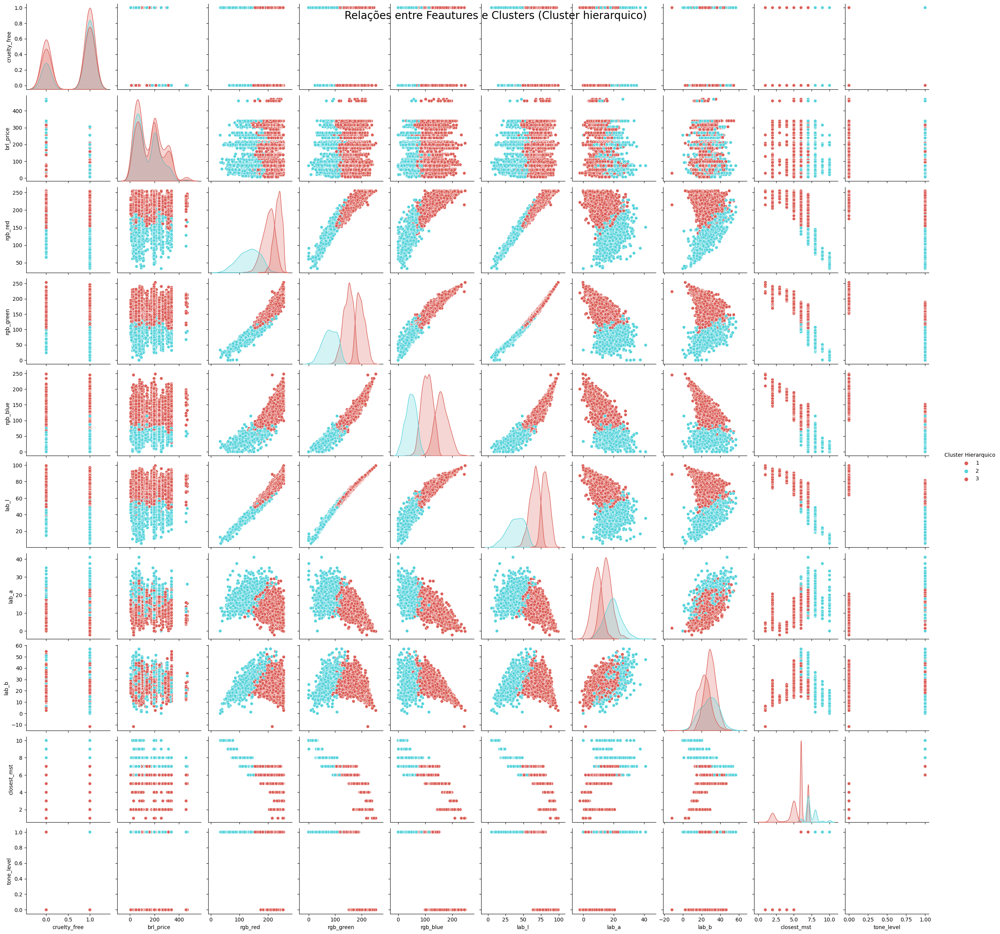

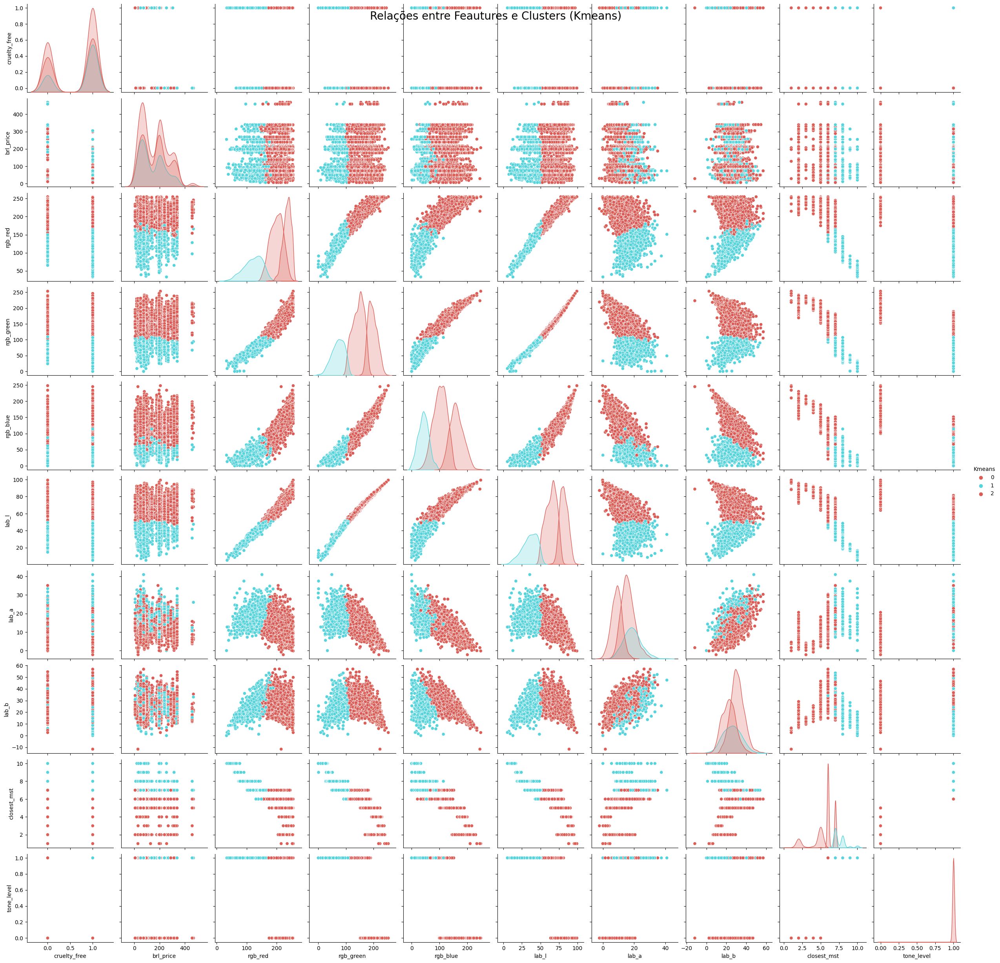

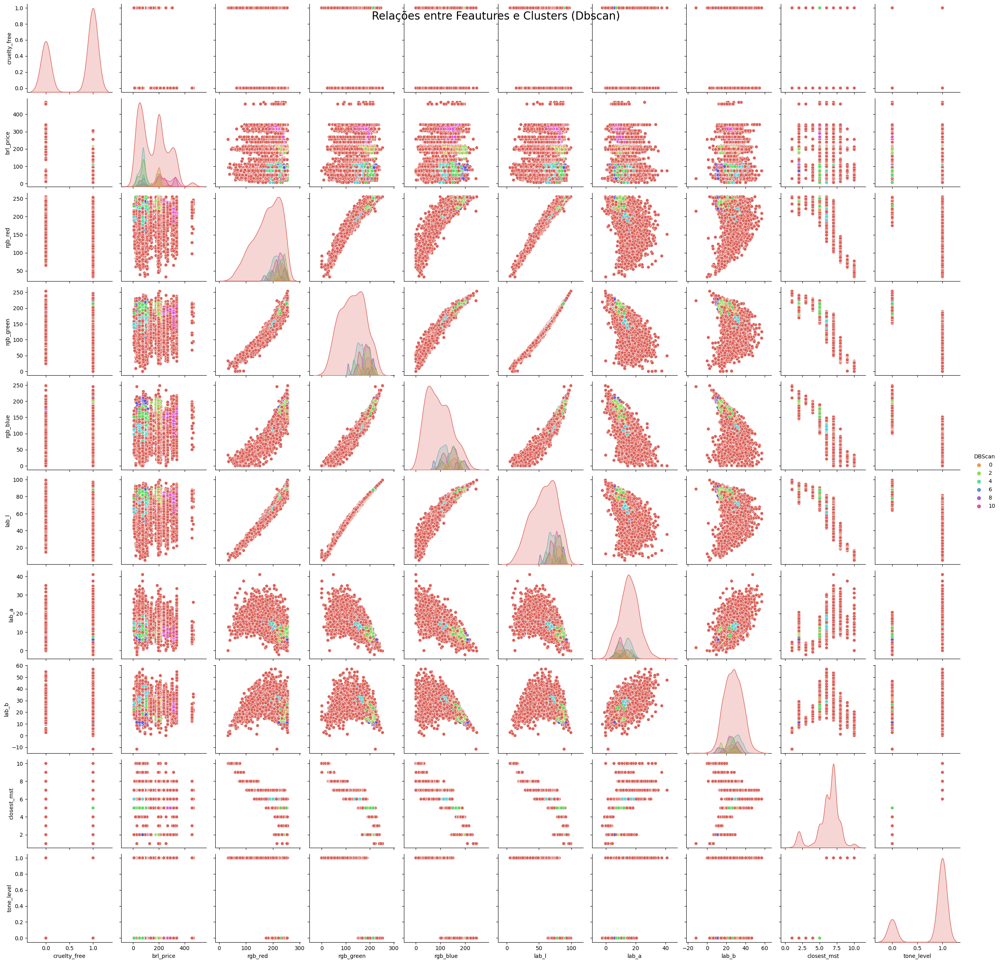

In [132]:
cluster_data = data[['cruelty_free', 'brl_price', 'rgb_red', 'rgb_green', 'rgb_blue', 'lab_l', 'lab_a', 'lab_b',
                     'closest_mst', 'tone_level', 'Cluster Hierarquico', 'Kmeans', 'DBScan']]

# gera pairplot para analisar as relações entre as feautures e clusters (para cada algoritmo de clusterização)
algorithms = ['Cluster Hierarquico', 'Kmeans', 'DBScan']
for algorithm in algorithms:
    sns.pairplot(cluster_data, hue=algorithm, palette='hls', diag_kind='kde', vars=['cruelty_free', 'brl_price', 
                                                                                   'rgb_red', 'rgb_green', 'rgb_blue', 
                                                                                   'lab_l', 'lab_a', 'lab_b', 'closest_mst', 'tone_level'])
    plt.suptitle(f'Relações entre Feautures e Clusters ({algorithm.capitalize()})', fontsize=20)
    plt.show()

### Scatterplot

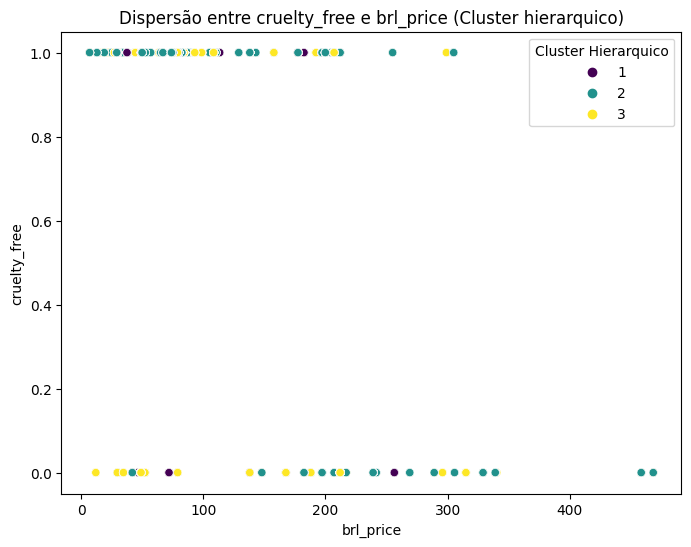

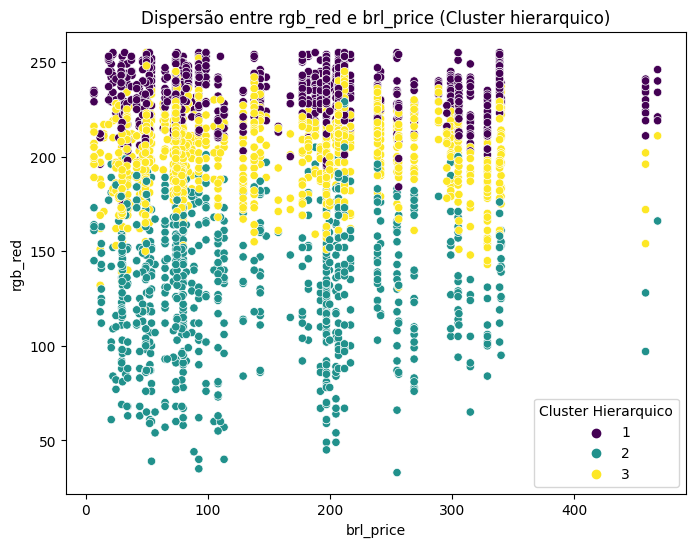

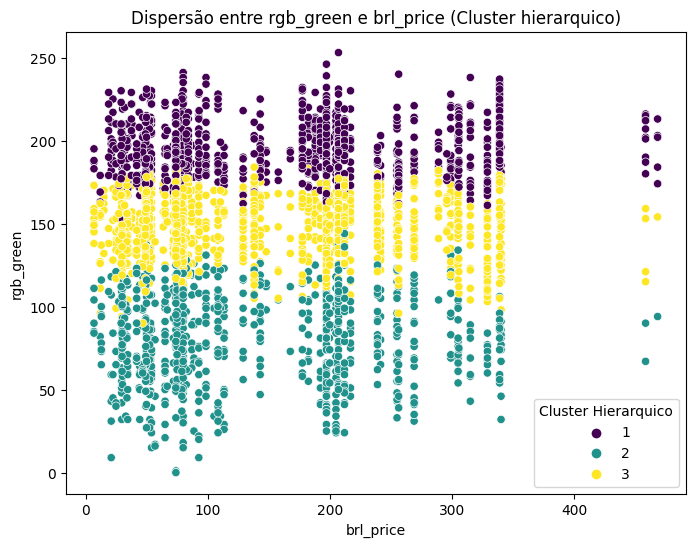

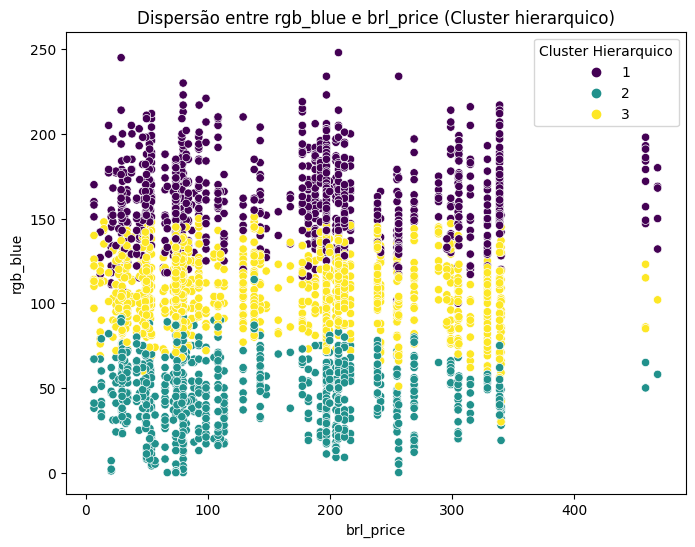

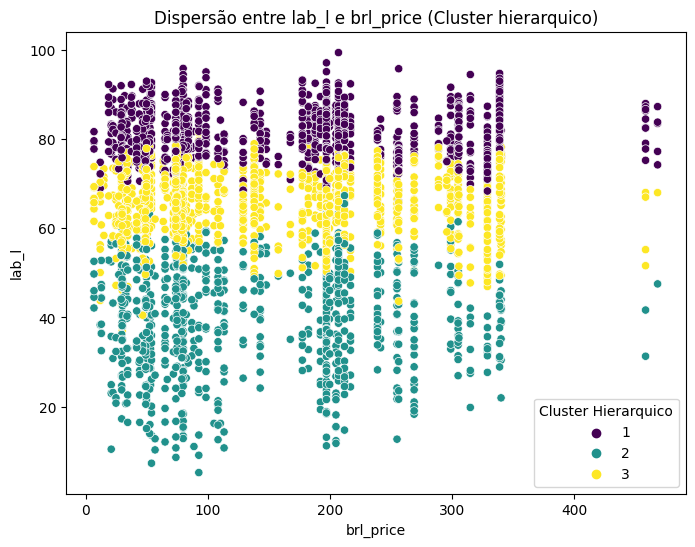

...

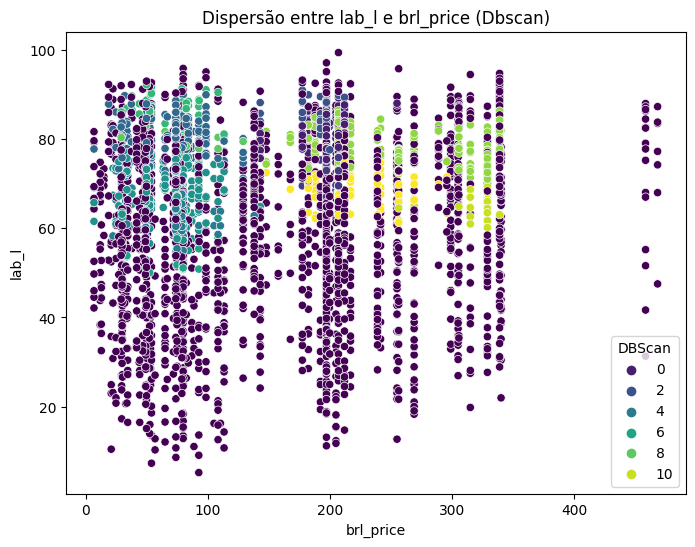

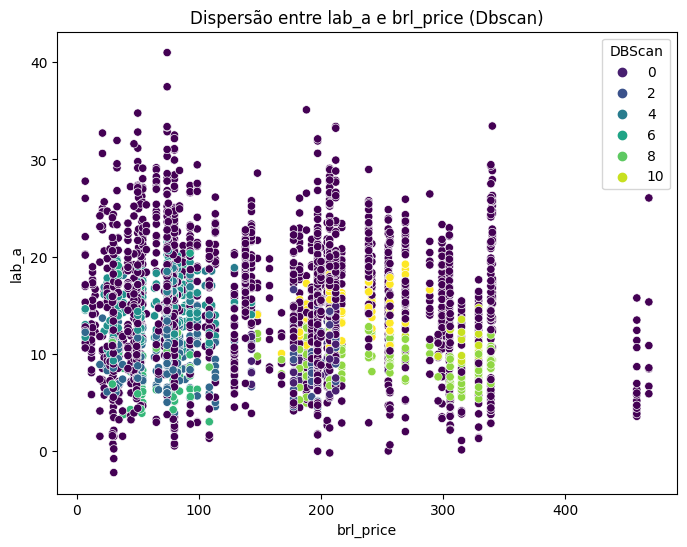

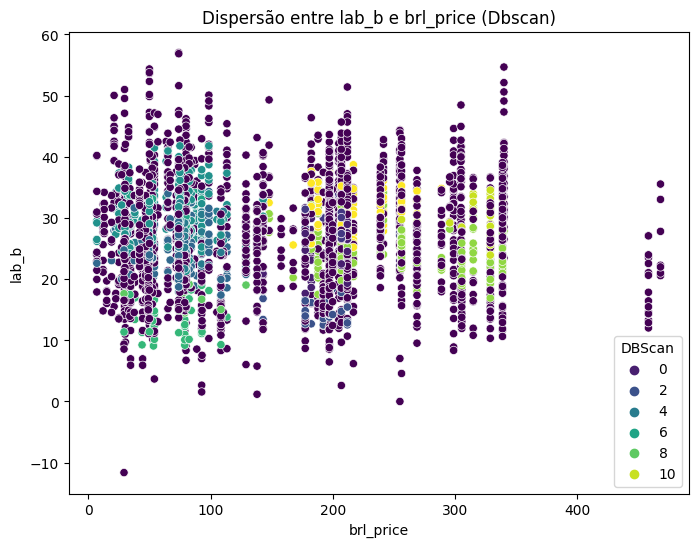

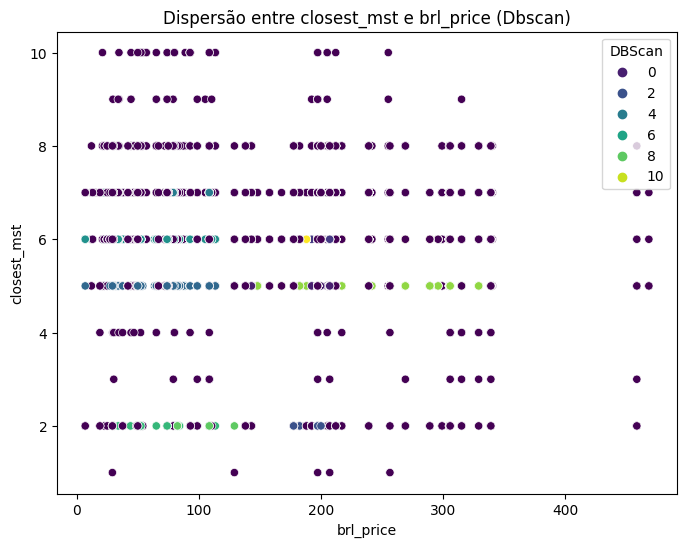

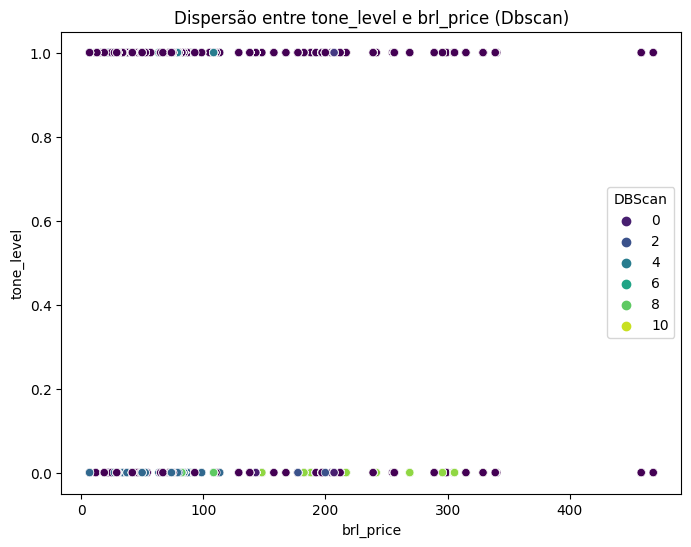

In [133]:
# scatterplot separado para cada algoritmo de clusterização
algorithms = ['Cluster Hierarquico', 'Kmeans', 'DBScan']
scatter_columns = ['cruelty_free', 'rgb_red', 'rgb_green', 'rgb_blue', 'lab_l', 'lab_a', 'lab_b', 'closest_mst', 'tone_level']

for algorithm in algorithms:
    for col in scatter_columns:
        plt.figure(figsize=(8, 6))
        sns.scatterplot(data=cluster_data, x='brl_price', y=col, hue=algorithm, palette='viridis')
        plt.title(f'Dispersão entre {col} e brl_price ({algorithm.capitalize()})')
        plt.xlabel('brl_price')
        plt.ylabel(col)
        plt.legend(title=algorithm)
        plt.show()

### Interativo com informações dos dados qualitativos

In [134]:
import plotly.express as px

cluster_data = data[['brand', 'line', 'tone','cruelty_free', 'brl_price', 'rgb_red', 'rgb_green', 'rgb_blue', 'lab_l', 'lab_a', 'lab_b',
                     'closest_mst', 'tone_level', 'Cluster Hierarquico', 'Kmeans', 'DBScan']]

# scatterplot interativo separado para cada algoritmo de clusterização
algorithms = ['Cluster Hierarquico', 'Kmeans', 'DBScan']
scatter_columns = ['cruelty_free', 'rgb_red', 'rgb_green', 'rgb_blue', 'lab_l', 'lab_a', 'lab_b', 'closest_mst', 'tone_level']

for algorithm in algorithms:
    for col in scatter_columns:
        fig = px.scatter(cluster_data, x='brl_price', y=col, color=algorithm,
                         title=f'Dispersão entre {col} e brl_price ({algorithm.capitalize()})',
                         labels={'brl_price': 'brl_price', col: col}, 
                         hover_data=['brand', 'line', 'tone'], 
                         template='plotly', opacity=0.7)
        fig.update_traces(marker=dict(size=8))
        fig.show()